# 1. Utilize o opencv para:

1. Recortar parte de uma imagem
2. Desenhar um retângulo de uma imagem
3. Escrever um texto em uma imagem
4. Diminuir a dimensão de uma imagem em 30 % de modo proporcional

# 2. Escolha imagens para serem classificadas usando Transformers.

# 3. Escolha imagens para testar os dois modelos de detecção de objetos

1. Teste diferentes valores de threshold e avalie quais objetos não são identificados

# 4. Monte alguns exemplos de detecção de objeto usando zero-shot- detection

In [ ]:
# INSTALLERS
!pip install transformers
!pip install timm
!pip install transformers evaluate datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 22.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 33.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 60.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 56.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.4/81.4 kB 2.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.3/519.3 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 9.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.9 MB/s eta 0:00:00


In [ ]:
# IMPORTS
import cv2 as cv
import numpy as np
import imutils
import skimage
import requests
import torch
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw
from transformers import pipeline, AutoImageProcessor, AutoModelForObjectDetection, AutoProcessor, AutoModelForZeroShotObjectDetection
from tqdm import tqdm

device = "cuda" if torch.cuda.is_available() else "cpu"


<class 'PIL.PngImagePlugin.PngImageFile'>


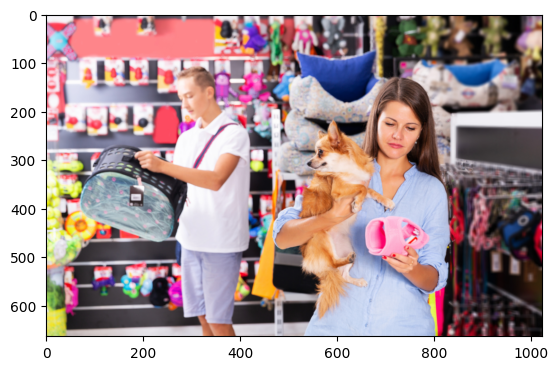

In [ ]:
url = "https://caesegatos.com.br/wp-content/uploads/2022/08/petshop-1-1024x664.png"
img = Image.open(requests.get(url, stream=True).raw)
print(type(img))
plt.imshow(img)

# 1.1. Recortar parte de uma imagem

In [ ]:
# converte a imagem para um array numpy
img_np = np.array(img)
img_np.shape

(664, 1024, 4)

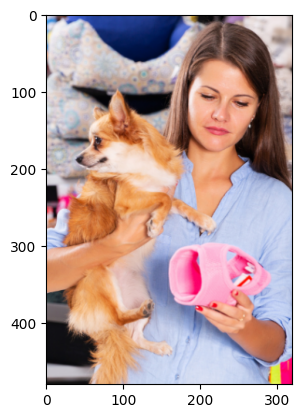

In [ ]:
# Y:Y X:X
roi = img_np[120:600, 500:820]
plt.imshow(roi)

#1.2. Desenhar um retângulo na imagem

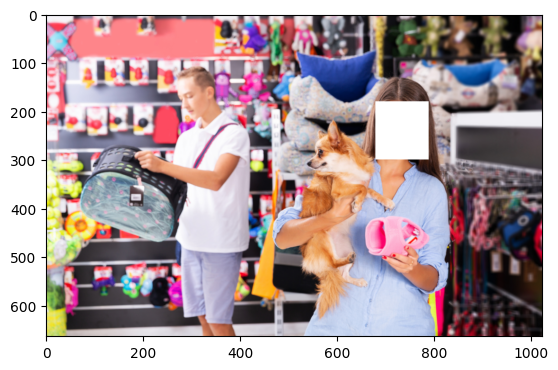

In [ ]:
img_ret = copy(img_np)
img_ret[180:300,680:790] = [255,255,255,255]
plt.imshow(img_ret)

#1.3. Escrever um texto na imagem

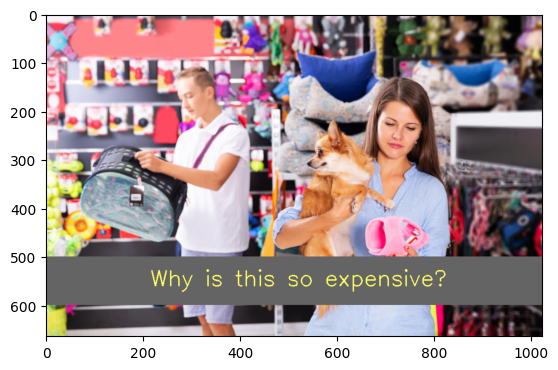

In [ ]:
img_ret2 = copy(img_np)
img_ret2[500:600,0:1024] = [100,100,100,255]
cv.putText(img_ret2, "Why is this so expensive?", (215,560),
           cv.FONT_HERSHEY_SIMPLEX, 1.5, (255, 255, 102, 255), 2)
plt.imshow(img_ret2)

#1.4. Diminuir a dimensão de uma imagem em 30 % de modo proporcional

Dimensões Originais :  (664, 1024, 4)
novas dimensões :  (199, 307, 4)


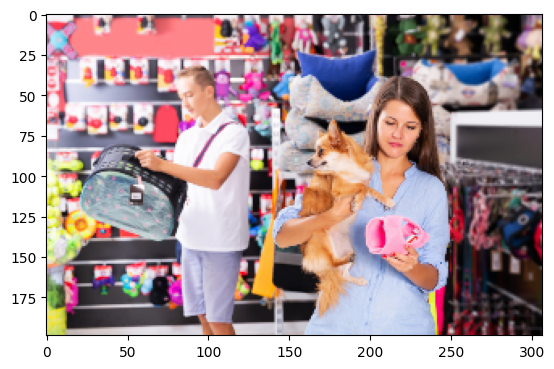

In [ ]:
print('Dimensões Originais : ',img_np.shape)

scale_percent = 30 # porcentagem da imagem original

width = int(img_np.shape[1] * scale_percent / 100)
height = int(img_np.shape[0] * scale_percent / 100)
dim = (width, height)

# resize image
resized = cv.resize(img_np,dim)

print('novas dimensões : ',resized.shape)
plt.imshow(resized)

#2. Escolha imagens para serem classificadas usando Transformers

### Links das imagens escolhidas para classificação

### Cachorrinho correndo
* https://hips.hearstapps.com/hmg-prod/images/chihuahua-dog-running-across-grass-royalty-free-image-1580743445.jpg

### Carro de corrida
* https://www.dispatch.com/gcdn/authoring/2020/04/13/NCOD/ghows-OH-a32d227b-3cc0-3aeb-e053-0100007f6767-aabd23c2.jpeg

### Pipa em forma de morcego ou dragão (mais difícil)
* https://www.indystar.com/gcdn/-mm-/8213599674fe56a7247cd9ce23554dfaed4fd944/c=0-28-3161-1814/local/-/media/2016/03/14/INGroup/Indianapolis/635935695082456453-06-flyAkite-032115.jpg


### Utilizando os modelos e funções auxiliares do professor

In [ ]:
# model
model_name = "google/vit-base-patch16-224"
# image processor
image_processor = ViTImageProcessor.from_pretrained(model_name)
# model pré treinado
model = ViTForImageClassification.from_pretrained(model_name).to(device)

loading configuration file preprocessor_config.json from cache at /root/.cache/huggingface/hub/models--google--vit-base-patch16-224/snapshots/2ddc9d4e473d7ba52128f0df4723e478fa14fb80/preprocessor_config.json
size should be a dictionary on of the following set of keys: ({'width', 'height'}, {'shortest_edge'}, {'longest_edge', 'shortest_edge'}, {'longest_edge'}), got 224. Converted to {'height': 224, 'width': 224}.
Image processor ViTImageProcessor {
  "do_normalize": true,
  "do_rescale": true,
  "do_resize": true,
  "image_mean": [
    0.5,
    0.5,
    0.5
  ],
  "image_processor_type": "ViTImageProcessor",
  "image_std": [
    0.5,
    0.5,
    0.5
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "height": 224,
    "width": 224
  }
}

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--google--vit-base-patch16-224/snapshots/2ddc9d4e473d7ba52128f0df4723e478fa14fb80/config.json
Model config ViTConfig {
  "_name_or_path

In [ ]:
import urllib.parse as parse
import os

# Carregar de url
def is_url(string):
  try:
    result = parse.urlparse(string)
    # o método all estava dando erros, então substitui por uma versão mais simples, mas que dá o retorno desejado
    if result.scheme and result.netloc and result.path:
      return True
    else:
      return False
  except:
    return False

# Carregar do path
def load_image(image_path):
    print(f"Image path: {image_path}")
    if is_url(image_path):
        return Image.open(requests.get(image_path, stream=True).raw)
    elif os.path.exists(image_path):
        return Image.open(image_path)

In [ ]:
def get_prediction(model, url_or_path):
  # carregar imagem
  img = load_image(url_or_path)
  # preprocessing
  pixel_values = image_processor(img, return_tensors="pt")["pixel_values"].to(device)
  # inferencia
  output = model(pixel_values)
  # label id -- class name
  return model.config.id2label[int(output.logits.softmax(dim=1).argmax())]

### Classificando as imagens escolhidas

In [ ]:
get_prediction(model, "https://hips.hearstapps.com/hmg-prod/images/chihuahua-dog-running-across-grass-royalty-free-image-1580743445.jpg")

Image path: https://hips.hearstapps.com/hmg-prod/images/chihuahua-dog-running-across-grass-royalty-free-image-1580743445.jpg


'toy terrier'

In [ ]:
get_prediction(model, "https://www.dispatch.com/gcdn/authoring/2020/04/13/NCOD/ghows-OH-a32d227b-3cc0-3aeb-e053-0100007f6767-aabd23c2.jpeg")

Image path: https://www.dispatch.com/gcdn/authoring/2020/04/13/NCOD/ghows-OH-a32d227b-3cc0-3aeb-e053-0100007f6767-aabd23c2.jpeg


'racer, race car, racing car'

In [ ]:
get_prediction(model, "https://www.indystar.com/gcdn/-mm-/8213599674fe56a7247cd9ce23554dfaed4fd944/c=0-28-3161-1814/local/-/media/2016/03/14/INGroup/Indianapolis/635935695082456453-06-flyAkite-032115.jpg")

Image path: https://www.indystar.com/gcdn/-mm-/8213599674fe56a7247cd9ce23554dfaed4fd944/c=0-28-3161-1814/local/-/media/2016/03/14/INGroup/Indianapolis/635935695082456453-06-flyAkite-032115.jpg


'parachute, chute'

#3. Escolha imagens para testar os dois modelos de detecção de objetos
1. Teste diferentes valores de threshold e avalie quais objetos não são identificados

Preparando os dois pipelines para uma mesma imagem

In [ ]:
caminho = "https://www.upf.br/Media/odontologia-upf-1_192936.jpg"
image1 = Image.open(requests.get(caminho, stream=True).raw)
image2 = Image.open(requests.get(caminho, stream=True).raw)
obj_detector1 = pipeline("object-detection", model="facebook/detr-resnet-50")
obj_detector2 = pipeline("object-detection", model="devonho/detr-resnet-50_finetuned_cppe5")
obj_detector1(image1)
obj_detector2(image2)

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--facebook--detr-resnet-50/snapshots/480370a8aeeed9fc8d78837b4e94e5f936fe73f2/config.json
Model config DetrConfig {
  "_name_or_path": "facebook/detr-resnet-50",
  "activation_dropout": 0.0,
  "activation_function": "relu",
  "architectures": [
    "DetrForObjectDetection"
  ],
  "attention_dropout": 0.0,
  "auxiliary_loss": false,
  "backbone": "resnet50",
  "backbone_config": null,
  "bbox_cost": 5,
  "bbox_loss_coefficient": 5,
  "class_cost": 1,
  "classifier_dropout": 0.0,
  "d_model": 256,
  "decoder_attention_heads": 8,
  "decoder_ffn_dim": 2048,
  "decoder_layerdrop": 0.0,
  "decoder_layers": 6,
  "dice_loss_coefficient": 1,
  "dilation": false,
  "dropout": 0.1,
  "encoder_attention_heads": 8,
  "encoder_ffn_dim": 2048,
  "encoder_layerdrop": 0.0,
  "encoder_layers": 6,
  "eos_coefficient": 0.1,
  "giou_cost": 2,
  "giou_loss_coefficient": 2,
  "id2label": {
    "0": "N/A",
    "1": "person

[{'score': 0.9644530415534973,
  'label': 'Mask',
  'box': {'xmin': 701, 'ymin': 287, 'xmax': 786, 'ymax': 353}},
 {'score': 0.961094856262207,
  'label': 'Gloves',
  'box': {'xmin': 625, 'ymin': 540, 'xmax': 756, 'ymax': 615}},
 {'score': 0.9739634394645691,
  'label': 'Gloves',
  'box': {'xmin': 398, 'ymin': 528, 'xmax': 482, 'ymax': 602}},
 {'score': 0.9696127772331238,
  'label': 'Coverall',
  'box': {'xmin': 603, 'ymin': 128, 'xmax': 1000, 'ymax': 775}}]

Modelo 1

In [ ]:
image_processor1 = AutoImageProcessor.from_pretrained("facebook/detr-resnet-50")
model1 = AutoModelForObjectDetection.from_pretrained("facebook/detr-resnet-50")

loading configuration file preprocessor_config.json from cache at /root/.cache/huggingface/hub/models--facebook--detr-resnet-50/snapshots/480370a8aeeed9fc8d78837b4e94e5f936fe73f2/preprocessor_config.json
Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.
size should be a dictionary on of the following set of keys: ({'width', 'height'}, {'shortest_edge'}, {'longest_edge', 'shortest_edge'}, {'longest_edge'}), got 800. Converted to {'shortest_edge': 800, 'longest_edge': 1333}.
Image processor DetrImageProcessor {
  "do_normalize": true,
  "do_pad": true,
  "do_rescale": true,
  "do_resize": true,
  "format": "coco_detection",
  "image_mean": [
    0.485,
    0.456,
    0.406
  ],
  "image_processor_type": "DetrImageProcessor",
  "image_std": [
    0.229,
    0.224,
    0.225
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "longest_edge": 1

Modelo 2

In [ ]:
image_processor2 = AutoImageProcessor.from_pretrained("devonho/detr-resnet-50_finetuned_cppe5")
model2 = AutoModelForObjectDetection.from_pretrained("devonho/detr-resnet-50_finetuned_cppe5")

loading configuration file preprocessor_config.json from cache at /root/.cache/huggingface/hub/models--devonho--detr-resnet-50_finetuned_cppe5/snapshots/a6b19af515640adfb51492b40b59e498e71e3170/preprocessor_config.json
Image processor DetrImageProcessor {
  "do_normalize": true,
  "do_pad": true,
  "do_rescale": true,
  "do_resize": true,
  "format": "coco_detection",
  "image_mean": [
    0.485,
    0.456,
    0.406
  ],
  "image_processor_type": "DetrImageProcessor",
  "image_std": [
    0.229,
    0.224,
    0.225
  ],
  "resample": 2,
  "rescale_factor": 0.00392156862745098,
  "size": {
    "longest_edge": 1333,
    "shortest_edge": 800
  }
}

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--devonho--detr-resnet-50_finetuned_cppe5/snapshots/a6b19af515640adfb51492b40b59e498e71e3170/config.json
Model config DetrConfig {
  "_name_or_path": "devonho/detr-resnet-50_finetuned_cppe5",
  "activation_dropout": 0.0,
  "activation_function": "relu",
  

Threshold do modelo 1

In [ ]:
with torch.no_grad():
    inputs1 = image_processor1(images=image1, return_tensors="pt")
    outputs1 = model1(**inputs1)
    target_sizes1 = torch.tensor([image1.size[::-1]])
    results1 = image_processor1.post_process_object_detection(outputs1, threshold=0.5, target_sizes=target_sizes1)[0]

for score1, label1, box1 in zip(results1["scores"], results1["labels"], results1["boxes"]):
    box1 = [round(i, 2) for i in box1.tolist()]
    print(
        f"Detected {model1.config.id2label[label1.item()]} with confidence "
        f"{round(score1.item(), 3)} at location {box1}"
    )

Detected scissors with confidence 0.573 at location [619.39, 509.9, 660.01, 549.86]
Detected toilet with confidence 0.822 at location [1141.97, 620.22, 1199.87, 753.68]
Detected person with confidence 0.995 at location [79.93, 238.14, 554.36, 703.26]
Detected person with confidence 0.895 at location [386.25, 128.35, 1002.26, 850.44]
Detected scissors with confidence 0.717 at location [475.43, 469.69, 545.68, 594.44]
Detected person with confidence 0.978 at location [553.92, 125.59, 1011.08, 770.02]
Detected bottle with confidence 0.863 at location [759.21, 30.2, 791.68, 136.0]


Print do modelo 1

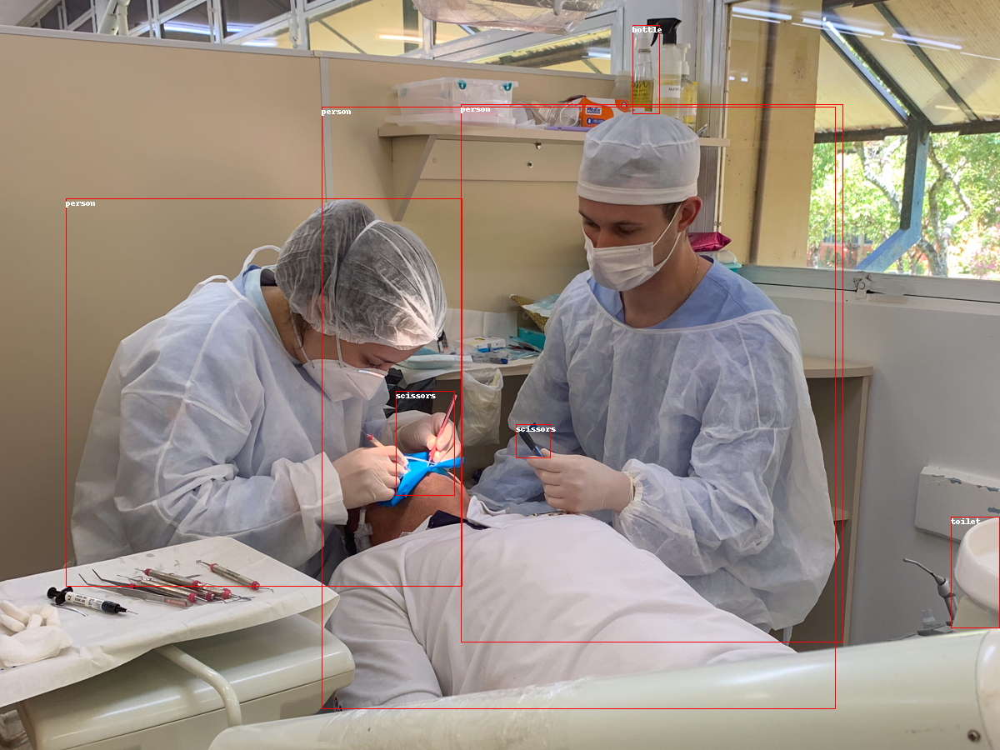

In [ ]:
draw = ImageDraw.Draw(image1)

for score1, label1, box1 in zip(results1["scores"], results1["labels"], results1["boxes"]):
    box1 = [round(i, 2) for i in box1.tolist()]
    x, y, x2, y2 = tuple(box1)
    draw.rectangle((x, y, x2, y2), outline="red", width=1)
    draw.text((x, y), model1.config.id2label[label1.item()], fill="white")

image1

* Com threshold=0.5 ele identifica os objetos nas mãos dos médicos como tesouras, as 3 pessoas, uma garrafa acima da cabeça do médico da direita e o cuspidor como toilet.
* Já com o valor em 0.2, ele identifica o pano azul na boca do paciente como tesoura (além dos objetos nas mãos dos médicos), e os dois objetos à direita (cuspidor e madeira acoplada na parede, ao lado do cuspidor) como toilet. Acima da cabeça do médico da direita ele identifica corretamente duas garrafas (tem 3, mas fazer o que...)
* Com o threshold em 0.75 ele identificou as três pessoas, o cuspidor como toilet e uma garrafa na cabeça do médico

Threshold do modelo 2

In [ ]:
with torch.no_grad():
    inputs2 = image_processor2(images=image2, return_tensors="pt")
    outputs2 = model2(**inputs2)
    target_sizes2 = torch.tensor([image2.size[::-1]])
    results2 = image_processor2.post_process_object_detection(outputs2, threshold=0.75, target_sizes=target_sizes2)[0]

for score2, label2, box2 in zip(results2["scores"], results2["labels"], results2["boxes"]):
    box2 = [round(i, 2) for i in box2.tolist()]
    print(
        f"Detected {model2.config.id2label[label2.item()]} with confidence "
        f"{round(score2.item(), 3)} at location {box2}"
    )

Detected Gloves with confidence 0.791 at location [503.58, 476.52, 560.46, 564.24]
Detected Mask with confidence 0.964 at location [701.77, 287.77, 786.16, 353.99]
Detected Gloves with confidence 0.961 at location [625.68, 540.71, 756.98, 615.23]
Detected Gloves with confidence 0.974 at location [398.87, 528.69, 482.97, 602.27]
Detected Face_Shield with confidence 0.865 at location [678.62, 191.41, 836.58, 394.96]
Detected Gloves with confidence 0.86 at location [457.98, 486.28, 554.26, 569.37]
Detected Coverall with confidence 0.97 at location [603.02, 128.44, 1000.77, 775.26]


Print do modelo 2

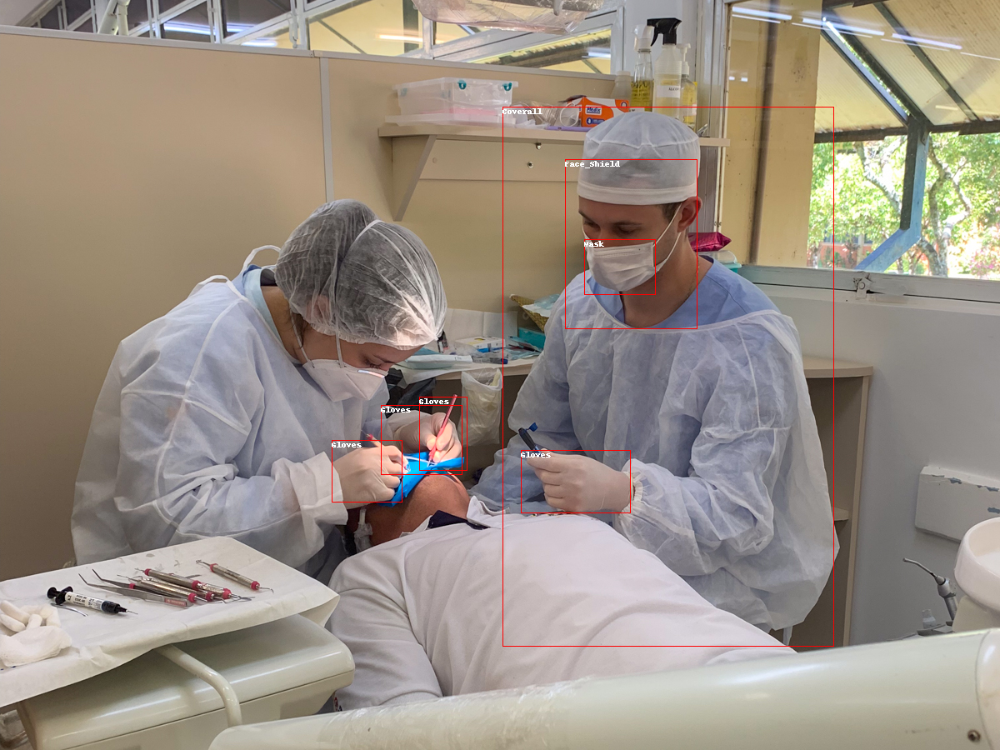

In [ ]:
draw = ImageDraw.Draw(image2)

for score2, label2, box2 in zip(results2["scores"], results2["labels"], results2["boxes"]):
    box2 = [round(i, 2) for i in box2.tolist()]
    x, y, x2, y2 = tuple(box2)
    draw.rectangle((x, y, x2, y2), outline="red", width=1)
    draw.text((x, y), model2.config.id2label[label2.item()], fill="white")

image2

* Com o threshold em 0.2, ele identifica corretamente o coverall dos dois médicos e a máscara do médico da direita. Identifica também as luvas nas mãos dos médicos mas identifica, equivocadamente, uma luva no pescoço da médica da esquerda. Há também um erro de identificação da face do médico da direita como face_shield e a caixa em cima da prateleira como googles.
* Com o threshold em 0.5 ele identifica corretamente as luvas, o coveral do médico da direita e a máscara do médico da direita, mas ignora a médica à esquerda. Identifica, equivocadamente, o rosto do médico da direita como face_shield.
* Com o valor em 0.75 o resultado é idêntico ao resultado do 0.5.

#4. Monte alguns exemplos de detecção de objeto usando zero-shot- detection

In [ ]:
checkpoint = "google/owlvit-base-patch32"
detector = pipeline(model=checkpoint, task="zero-shot-object-detection")

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/config.json
text_config is None. Initializing the OwlViTTextConfig with default values.
vision_config is None. initializing the OwlViTVisionConfig with default values.
Model config OwlViTConfig {
  "_name_or_path": "google/owlvit-base-patch32",
  "architectures": [
    "OwlViTForObjectDetection"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "owlvit",
  "projection_dim": 512,
  "text_config": {
    "bos_token_id": 0,
    "dropout": 0.0,
    "eos_token_id": 2,
    "max_length": 16,
    "model_type": "owlvit_text_model",
    "pad_token_id": 1
  },
  "text_config_dict": null,
  "torch_dtype": "float32",
  "transformers_version": "4.33.0",
  "vision_config": {
    "dropout": 0.0,
    "model_type": "owlvit_vision_model"
  },
  "vision_config_dict": null
}

loading configuration file con

loading weights file pytorch_model.bin from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/pytorch_model.bin
All model checkpoint weights were used when initializing OwlViTForObjectDetection.

All the weights of OwlViTForObjectDetection were initialized from the model checkpoint at google/owlvit-base-patch32.
If your task is similar to the task the model of the checkpoint was trained on, you can already use OwlViTForObjectDetection for predictions without further training.


loading file vocab.json from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/vocab.json
loading file merges.txt from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/merges.txt
loading file tokenizer.json from cache at None
loading file added_tokens.json from cache at None
loading file special_tokens_map.json from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/special_tokens_map.json
loading file tokenizer_config.json from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/tokenizer_config.json
ftfy or spacy is not installed using custom BasicTokenizer instead of ftfy.


loading configuration file preprocessor_config.json from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/preprocessor_config.json
Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.
size should be a dictionary on of the following set of keys: ({'width', 'height'}, {'shortest_edge'}, {'longest_edge', 'shortest_edge'}, {'longest_edge'}), got [768, 768]. Converted to {'height': 768, 'width': 768}.
size should be a dictionary on of the following set of keys: ({'width', 'height'}, {'shortest_edge'}, {'longest_edge', 'shortest_edge'}, {'longest_edge'}), got 768. Converted to {'height': 768, 'width': 768}.
Image processor OwlViTImageProcessor {
  "crop_size": {
    "height": 768,
    "width": 768
  },
  "do_center_crop": false,
  "do_convert_rgb": true,
  "do_normalize": true,
  "do_rescale": true,


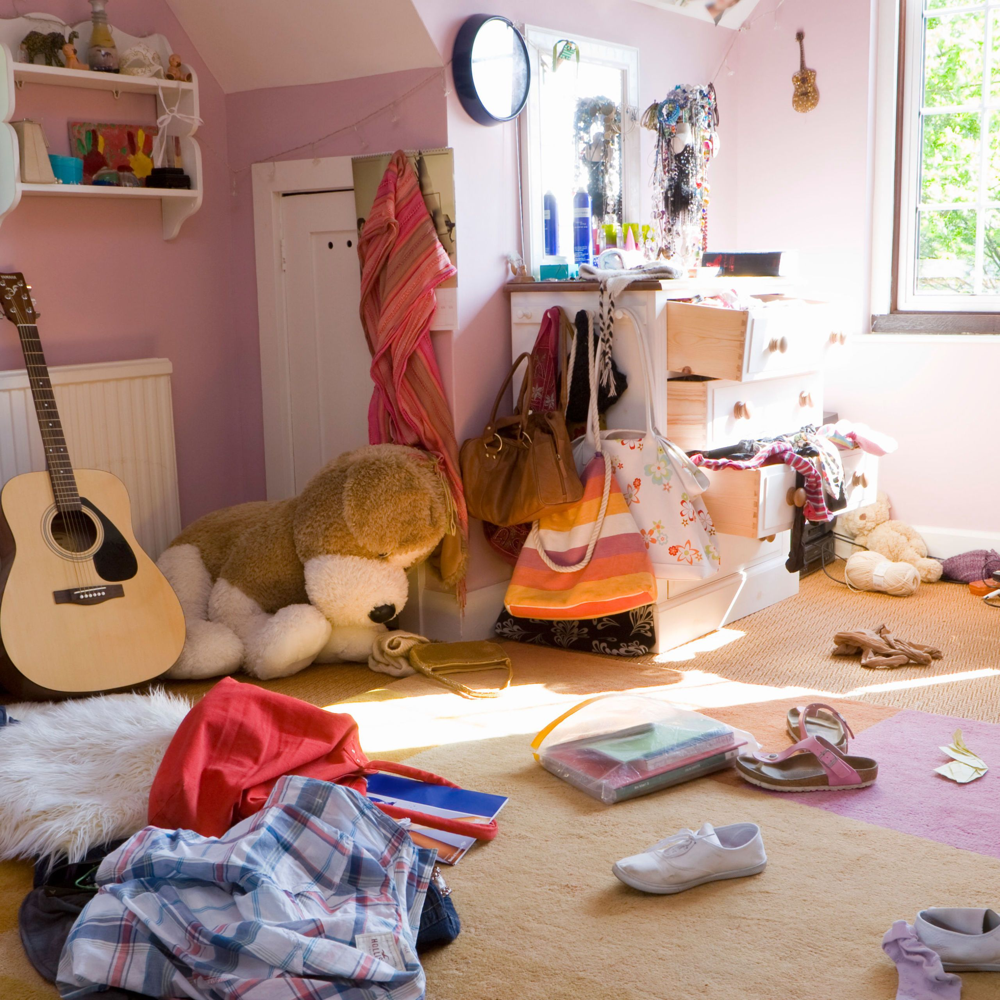

In [ ]:
url = "https://hips.hearstapps.com/netdoctor.cdnds.net/16/04/2560x2560/square-1453736594-messybedroom.jpg"
image_zs = Image.open(requests.get(url, stream=True).raw)
image_zs

In [ ]:
obj_detector = pipeline("object-detection", model="facebook/detr-resnet-50")

obj_detector(image_zs)

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--facebook--detr-resnet-50/snapshots/480370a8aeeed9fc8d78837b4e94e5f936fe73f2/config.json
Model config DetrConfig {
  "_name_or_path": "facebook/detr-resnet-50",
  "activation_dropout": 0.0,
  "activation_function": "relu",
  "architectures": [
    "DetrForObjectDetection"
  ],
  "attention_dropout": 0.0,
  "auxiliary_loss": false,
  "backbone": "resnet50",
  "backbone_config": null,
  "bbox_cost": 5,
  "bbox_loss_coefficient": 5,
  "class_cost": 1,
  "classifier_dropout": 0.0,
  "d_model": 256,
  "decoder_attention_heads": 8,
  "decoder_ffn_dim": 2048,
  "decoder_layerdrop": 0.0,
  "decoder_layers": 6,
  "dice_loss_coefficient": 1,
  "dilation": false,
  "dropout": 0.1,
  "encoder_attention_heads": 8,
  "encoder_ffn_dim": 2048,
  "encoder_layerdrop": 0.0,
  "encoder_layers": 6,
  "eos_coefficient": 0.1,
  "giou_cost": 2,
  "giou_loss_coefficient": 2,
  "id2label": {
    "0": "N/A",
    "1": "person

[{'score': 0.9719517230987549,
  'label': 'teddy bear',
  'box': {'xmin': 2134, 'ymin': 1319, 'xmax': 2419, 'ymax': 1511}},
 {'score': 0.9870367050170898,
  'label': 'teddy bear',
  'box': {'xmin': 385, 'ymin': 1150, 'xmax': 1171, 'ymax': 1752}},
 {'score': 0.9943576455116272,
  'label': 'handbag',
  'box': {'xmin': 1162, 'ymin': 821, 'xmax': 1497, 'ymax': 1381}}]

In [ ]:
predictions = detector(
    image_zs,
    candidate_labels=["guitar", "bear", "shoe", "book", "window", "clock"],
)

predictions


[{'score': 0.6875131130218506,
  'label': 'guitar',
  'box': {'xmin': -6, 'ymin': 697, 'xmax': 463, 'ymax': 1771}},
 {'score': 0.45375123620033264,
  'label': 'book',
  'box': {'xmin': 1372, 'ymin': 1814, 'xmax': 1910, 'ymax': 2063}},
 {'score': 0.38915807008743286,
  'label': 'clock',
  'box': {'xmin': 1155, 'ymin': 36, 'xmax': 1367, 'ymax': 322}},
 {'score': 0.35814255475997925,
  'label': 'book',
  'box': {'xmin': 912, 'ymin': 1962, 'xmax': 1300, 'ymax': 2179}},
 {'score': 0.3412055969238281,
  'label': 'guitar',
  'box': {'xmin': 1271, 'ymin': 1110, 'xmax': 1711, 'ymax': 1668}},
 {'score': 0.32897838950157166,
  'label': 'window',
  'box': {'xmin': 1289, 'ymin': 74, 'xmax': 1652, 'ymax': 713}},
 {'score': 0.32747626304626465,
  'label': 'bear',
  'box': {'xmin': 18, 'ymin': 1160, 'xmax': 1243, 'ymax': 1847}},
 {'score': 0.3178117573261261,
  'label': 'window',
  'box': {'xmin': 2214, 'ymin': -3, 'xmax': 2559, 'ymax': 837}},
 {'score': 0.2995845079421997,
  'label': 'shoe',
  'box':

In [ ]:
model3 = AutoModelForZeroShotObjectDetection.from_pretrained(checkpoint)
processor3 = AutoProcessor.from_pretrained(checkpoint)

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--google--owlvit-base-patch32/snapshots/17740e19dde58d657d21b970ead1cce0ea40f4da/config.json
text_config is None. Initializing the OwlViTTextConfig with default values.
vision_config is None. initializing the OwlViTVisionConfig with default values.
Model config OwlViTConfig {
  "_name_or_path": "google/owlvit-base-patch32",
  "architectures": [
    "OwlViTForObjectDetection"
  ],
  "initializer_factor": 1.0,
  "logit_scale_init_value": 2.6592,
  "model_type": "owlvit",
  "projection_dim": 512,
  "text_config": {
    "bos_token_id": 0,
    "dropout": 0.0,
    "eos_token_id": 2,
    "max_length": 16,
    "model_type": "owlvit_text_model",
    "pad_token_id": 1
  },
  "text_config_dict": null,
  "torch_dtype": "float32",
  "transformers_version": "4.33.0",
  "vision_config": {
    "dropout": 0.0,
    "model_type": "owlvit_vision_model"
  },
  "vision_config_dict": null
}

loading weights file pytorch_m

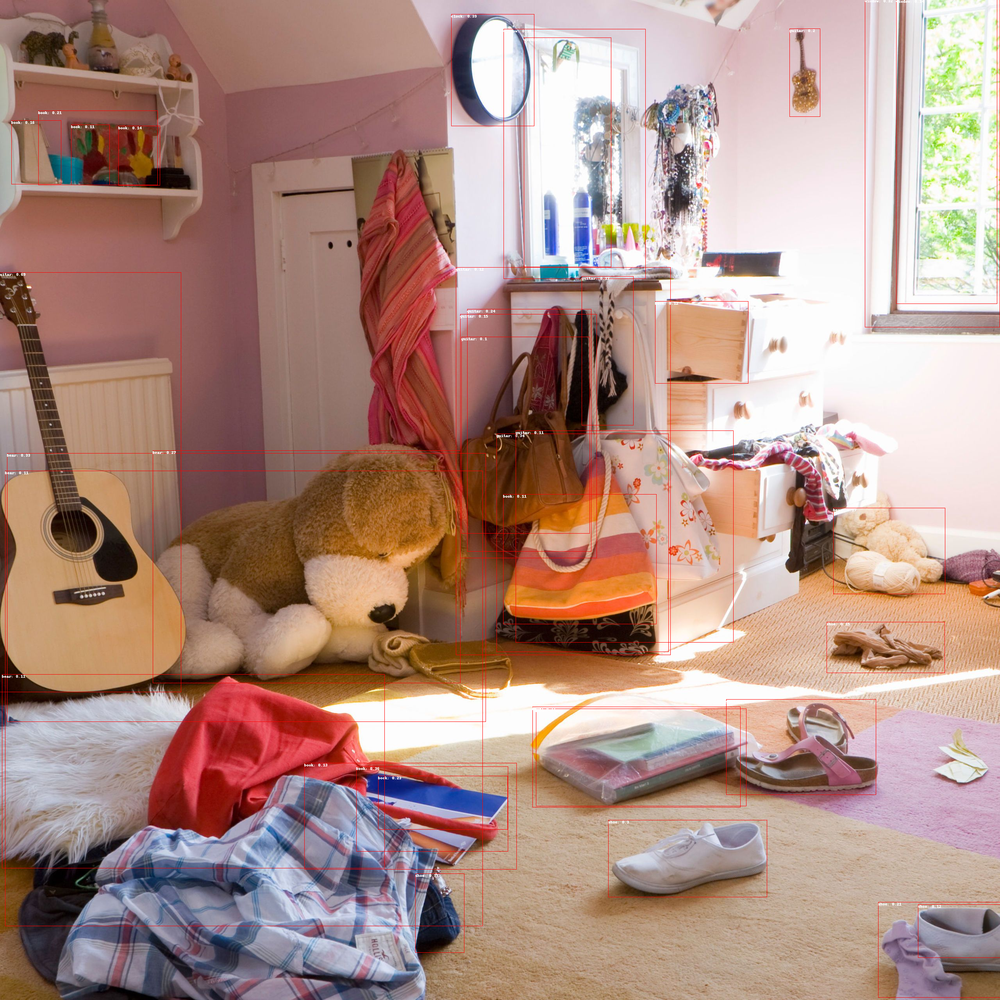

In [ ]:
draw = ImageDraw.Draw(image_zs)

for prediction in predictions:
    box = prediction["box"]
    label = prediction["label"]
    score = prediction["score"]

    xmin, ymin, xmax, ymax = box.values()
    draw.rectangle((xmin, ymin, xmax, ymax), outline="red", width=1)
    draw.text((xmin, ymin), f"{label}: {round(score,2)}", fill="white")

image_zs